In [17]:
import os
import json
from io import BytesIO

import librosa
import numpy as np
from matplotlib import pyplot as plt
import IPython.display as ipd

import music

In [18]:
# paths
base_dir = '..'
audio_dir = os.path.join(base_dir, 'backend', 'res', 'audio')
beatmap_dir = os.path.join(base_dir, 'backend', 'res', 'beatmaps')
vis_dir = os.path.join(base_dir, 'backend', 'res', 'beatmap_vis')

os.makedirs(vis_dir, exist_ok=True)

In [19]:
# audio_file = 'res/audio/yoasobi_idol_short.mp3'
audio_file = 'res/audio/yoasobi_idol.mp3'
audio_file = 'res/audio/abba_dancing_queen.mp3'

In [20]:
ipd.display(ipd.Audio(audio_file))

In [21]:
y, sr = librosa.load(audio_file)

In [22]:
thres = 500

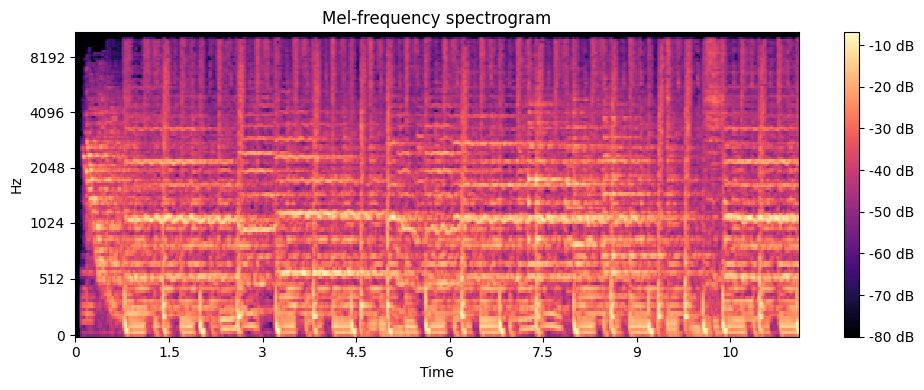

In [23]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)
S_dB = librosa.power_to_db(S, ref=np.max)[:,:thres]

# Plot the spectrogram
plt.figure(figsize=(10, 4))

librosa.display.specshow(S_dB, sr=sr, x_axis='time', y_axis='mel')

plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram')
plt.tight_layout()
plt.show()

In [24]:
# Produce onset envelope
onset_env = librosa.onset.onset_strength(y=y, sr=sr)

# Select the locations of onsets in the envelope
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_env, sr=sr)

# extract values of the onset envelope at the beat locations
tempo_frames = onset_env[onset_frames]

rmse = librosa.feature.rms(y=y)[0]  # root mean square energy

In [62]:
spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

In [70]:
## SPECTRAL CENTROID METHOD

low_pitch, hi_pitch = np.percentile(spectral_centroid, q=[30, 70])

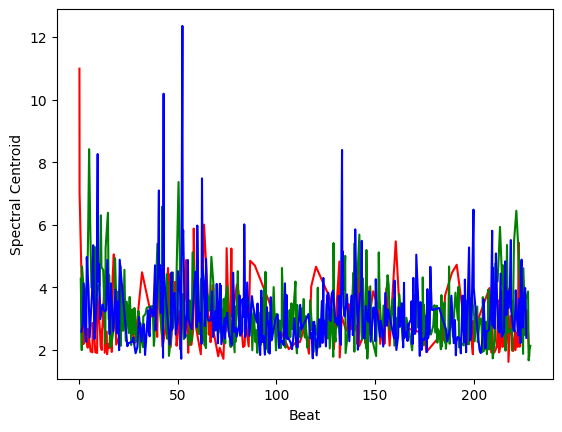

In [109]:

times = librosa.times_like(onset_env, sr=sr)

lo_times = spectral_centroid[onset_frames] < low_pitch
hi_times = spectral_centroid[onset_frames] > hi_pitch
mid_times = np.logical_not(np.logical_or(lo_times, hi_times))

plt.plot(times[onset_frames][lo_times], onset_env[onset_frames][lo_times], color='r')
plt.plot(times[onset_frames][mid_times], onset_env[onset_frames][mid_times], color='g')
plt.plot(times[onset_frames][hi_times], onset_env[onset_frames][hi_times], color='b')
plt.xlabel('Beat')
plt.ylabel('Spectral Centroid')
plt.show()

431


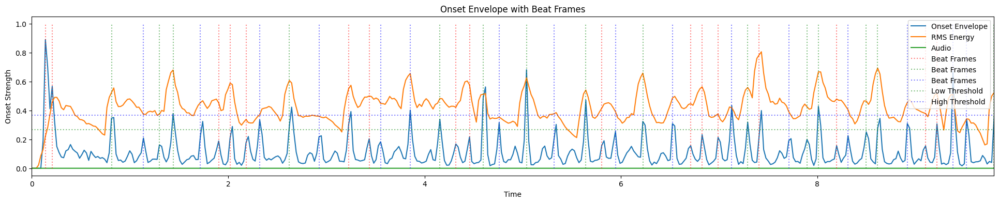

In [106]:
# Show the onset envelope
thres = 10 # seconds

times_ = librosa.times_like(onset_env, sr=sr)
times = times_[times_ < thres]
plt.figure(figsize=(24, 4))
plt.plot(times, onset_env[:len(times)]/onset_env.max(), label='Onset Envelope')
plt.plot(times, rmse[:len(times)]/max(rmse), label='RMS Energy')
plt.plot(times, y[:len(times)]/max(y), label='Audio')
print(len(times))

onset_frames_ = [onset_frames[i] for i in range(len(onset_frames)) if onset_frames[i] < len(times)]
sorter = onset_env #rmse
levels = sorter[onset_frames_]/max(sorter)
low_thres, hi_thres = np.percentile(levels, q=[50, 80])
# onset_frames_2 = [onset_frames[i] for i in range(len(onset_frames)) if onset_frames[i] < 909]

# plt.vlines(times[onset_frames_], 0, 1, color='r', linestyle=':', alpha=0.5, label='Beat Frames')
plt.vlines(times_[onset_frames][lo_times], 0, 1, color='r', linestyle=':', alpha=0.5, label='Beat Frames')
plt.vlines(times_[onset_frames][mid_times], 0, 1, color='g', linestyle=':', alpha=0.5, label='Beat Frames')
plt.vlines(times_[onset_frames][hi_times], 0, 1, color='b', linestyle=':', alpha=0.5, label='Beat Frames')
plt.hlines(low_thres, 0, times[-1], color='g', linestyle=':', alpha=0.5, label='Low Threshold')
plt.hlines(hi_thres, 0, times[-1], color='b', linestyle=':', alpha=0.5, label='High Threshold')

plt.xlabel('Time')
plt.ylabel('Onset Strength')
plt.title('Onset Envelope with Beat Frames')
plt.xlim(0, times[onset_frames_][-1])
plt.legend()

plt.show()

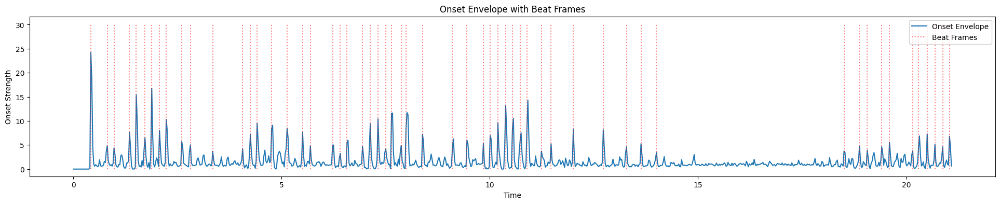

In [101]:
clicks = librosa.clicks(frames=onset_frames, sr=sr, length=len(y))
ipd.Audio(y + clicks, rate=sr)

In [107]:
# Large sound?
clicks = librosa.clicks(frames=onset_frames[sorter[onset_frames]/max(sorter) > hi_thres], sr=sr, length=len(y))
ipd.Audio(y + clicks, rate=sr)

In [103]:
# Low frequency?
clicks = librosa.clicks(frames=onset_frames[lo_times], sr=sr, length=len(y))
ipd.Audio(y + clicks, rate=sr)